In [1]:
# Importações

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns


from src.config import CLEANED_PATH

In [2]:
# Obtendo a base de dados
df = pd.read_parquet(CLEANED_PATH)

df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_households,population_per_households,bedrooms_per_rooms,median_income_cat,housing_median_age_cat
0,-122.230003,37.880001,41,880,129,322,126,8.3252,452600,NEAR BAY,6.984127,2.555556,0.146591,5,3
1,-122.220001,37.860001,21,7099,1106,2401,1138,8.3014,358500,NEAR BAY,6.238137,2.109842,0.155797,5,2
2,-122.239998,37.849998,52,1467,190,496,177,7.2574,352100,NEAR BAY,8.288136,2.802260,0.129516,5,4
3,-122.250000,37.849998,52,1274,235,558,219,5.6431,341300,NEAR BAY,5.817352,2.547945,0.184458,4,4
4,-122.250000,37.849998,52,1627,280,565,259,3.8462,342200,NEAR BAY,6.281853,2.181467,0.172096,3,4


In [3]:
# Definição de cada tipo de coluna

target_column = pd.Index(["median_house_value"]).tolist()

categoric_columns = df.select_dtypes("object").columns.tolist()

numeric_columns = df.select_dtypes("number").columns.drop(target_column).tolist()

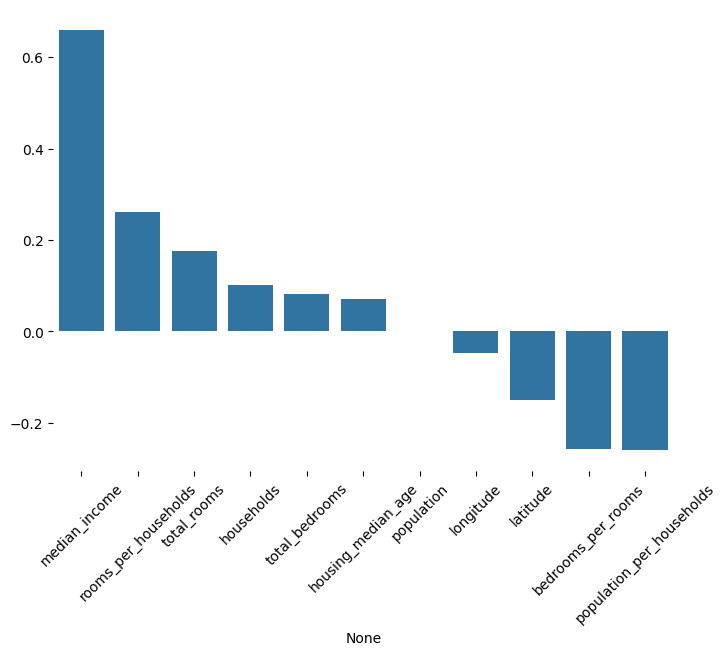

In [4]:
# Verificando a correlação de pearson entre a coluna alvo e as colunas numéricas

fig, ax = plt.subplots(figsize=(8, 6))

df_target_corr = df[
    numeric_columns + target_column
    ].corr()[target_column].sort_values(
        by=target_column[0], 
        ascending=False
    )[1:]

sns.barplot(
    x=df_target_corr.index, 
    y=df_target_corr.values.reshape(-1),
    ax=ax
    )

ax.set_frame_on(False)

ax.tick_params(axis='x', labelrotation=45)

plt.show()



In [5]:
# Verificando o valor exato das correlações entre o target e as colunas numéricas
df[
    numeric_columns + target_column
    ].corr()[target_column].sort_values(
        by=target_column[0], 
        ascending=False
    )[1:]

,median_house_value
median_income,0.658809
rooms_per_households,0.260986
total_rooms,0.176858
households,0.101844
total_bedrooms,0.081989
housing_median_age,0.071927
population,0.000782
longitude,-0.046358
latitude,-0.149946
bedrooms_per_rooms,-0.257877


Percebe-se que apenas `median_income` apresenta uma correlação de pearson relativamente forte com a coluna alvo. Como as demais colunas não apresentam esse comportamento, talvez seja interessante gerar colunas derivadas dessas colunas.

<Axes: >

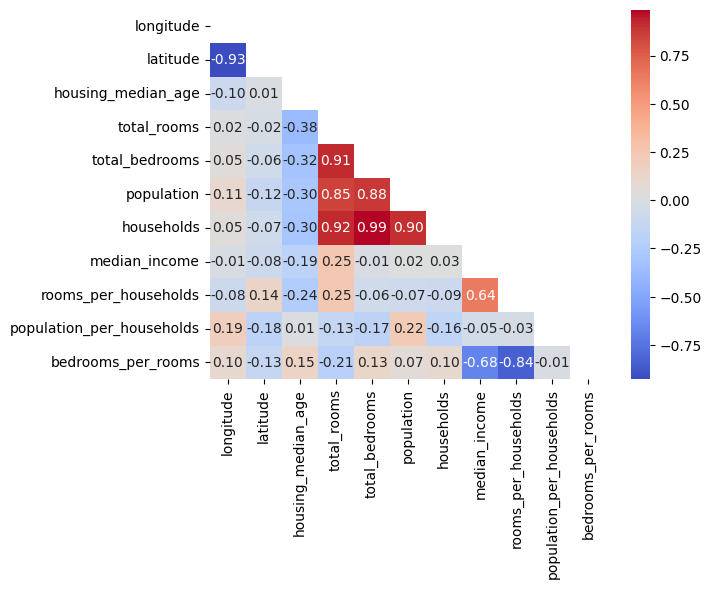

In [6]:
# Verificando o mapa de calor com as correlações entre as colunas numéricas

sup_triangle = np.triu(df[numeric_columns].corr())

sns.heatmap(
    data=df[numeric_columns].corr(),
    mask=sup_triangle,
    annot=True,
    cmap="coolwarm",
    fmt=".2f"
)

As colunas derivadas podem ser geradas a partir de colunas com alta colinearidade (Correlação de Pearson muito alta). Então podemos gerar as seguintes colunas derivadas:

- rooms_per_households
- population_per_households
- bedrooms_per_rooms

In [7]:
# Gerando as novas colunas derivadas listadas

df["rooms_per_households"] = df["total_rooms"] / df["households"]
df["population_per_households"] = df["population"] / df["households"]
df["bedrooms_per_rooms"] = df["total_bedrooms"] / df["total_rooms"]

df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_households,population_per_households,bedrooms_per_rooms,median_income_cat,housing_median_age_cat
0,-122.230003,37.880001,41,880,129,322,126,8.3252,452600,NEAR BAY,6.984127,2.555556,0.146591,5,3
1,-122.220001,37.860001,21,7099,1106,2401,1138,8.3014,358500,NEAR BAY,6.238137,2.109842,0.155797,5,2
2,-122.239998,37.849998,52,1467,190,496,177,7.2574,352100,NEAR BAY,8.288136,2.802260,0.129516,5,4
3,-122.250000,37.849998,52,1274,235,558,219,5.6431,341300,NEAR BAY,5.817352,2.547945,0.184458,4,4
4,-122.250000,37.849998,52,1627,280,565,259,3.8462,342200,NEAR BAY,6.281853,2.181467,0.172096,3,4


In [8]:
# Resumo estatístico com essas colunas derivadas

df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_households,population_per_households,bedrooms_per_rooms
count,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000,18540.000000
mean,-119.588524,35.663578,28.631068,2473.296710,508.898058,1362.223355,478.003020,3.677522,191565.425944,5.238514,2.916469,0.212205
std,2.008403,2.149676,12.374988,1571.918137,316.933581,835.662092,292.013681,1.534593,96482.662561,1.131943,0.692657,0.048438
min,-124.349998,32.540001,1.000000,6.000000,2.000000,3.000000,2.000000,0.499900,14999.000000,1.714286,0.750000,0.113535
25%,-121.790001,33.930000,18.000000,1451.000000,298.000000,803.000000,284.000000,2.541700,115500.000000,4.438090,2.448467,0.177575
50%,-118.540001,34.279999,29.000000,2107.000000,433.000000,1173.000000,410.500000,3.458300,173800.000000,5.183812,2.834070,0.204129
75%,-118.000000,37.730000,37.000000,3077.000000,634.000000,1704.250000,595.000000,4.582500,247900.000000,5.944873,3.289914,0.239501
max,-114.550003,41.950001,52.000000,11026.000000,2205.000000,5804.000000,1979.000000,10.594100,489800.000000,10.321168,5.392954,0.406295


In [9]:
# Atualizando os tipos das colunas

numeric_columns = df.select_dtypes("number").columns.drop(target_column).tolist()

In [10]:
numeric_columns

['longitude',
 'latitude',
 'housing_median_age',
 'total_rooms',
 'total_bedrooms',
 'population',
 'households',
 'median_income',
 'rooms_per_households',
 'population_per_households',
 'bedrooms_per_rooms']

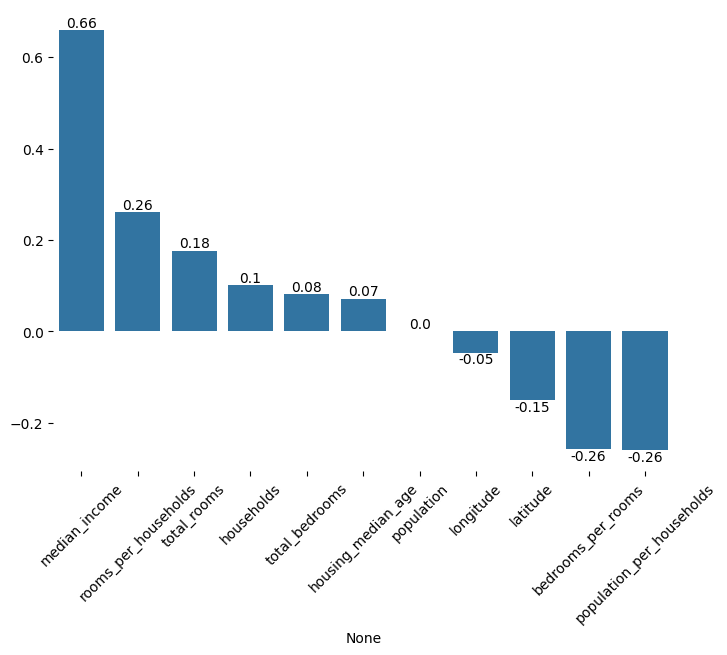

In [11]:
# Verificando a correlação de pearson entre a coluna alvo com as colunas numéricas

fig, ax = plt.subplots(figsize=(8, 6))

df_target_corr = df[
    numeric_columns + target_column
    ].corr()[target_column].sort_values(
        by=target_column[0], 
        ascending=False
    )[1:]

b = sns.barplot(
    x=df_target_corr.index, 
    y=df_target_corr.values.reshape(-1),
    ax=ax
    )

for container in b.containers:

    b.bar_label(container, labels=[round(artist.get_height(), 2) for artist in container])

ax.set_frame_on(False)

ax.tick_params(axis='x', labelrotation=45)

plt.show()

<Axes: >

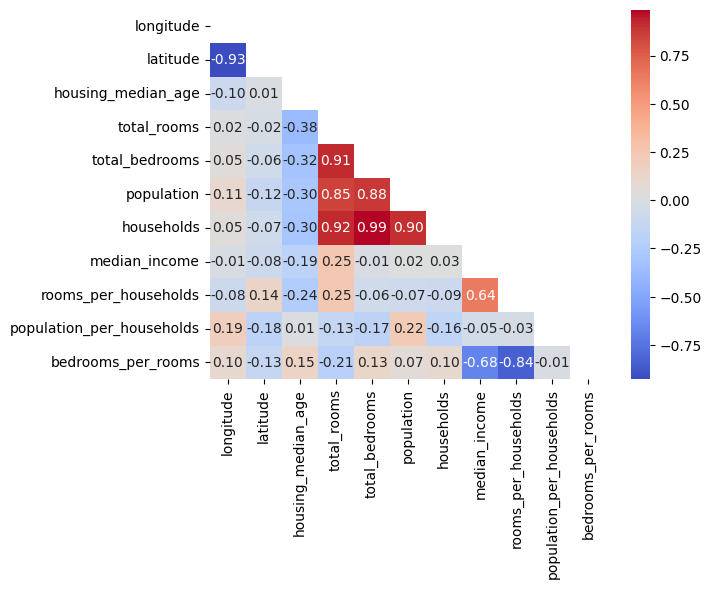

In [12]:
# Verificando o mapa de calor com as correlações entre as colunas numéricas

sup_triangle = np.triu(df[numeric_columns].corr())

sns.heatmap(
    data=df[numeric_columns].corr(),
    mask=sup_triangle,
    annot=True,
    cmap="coolwarm",
    fmt=".2f"
)

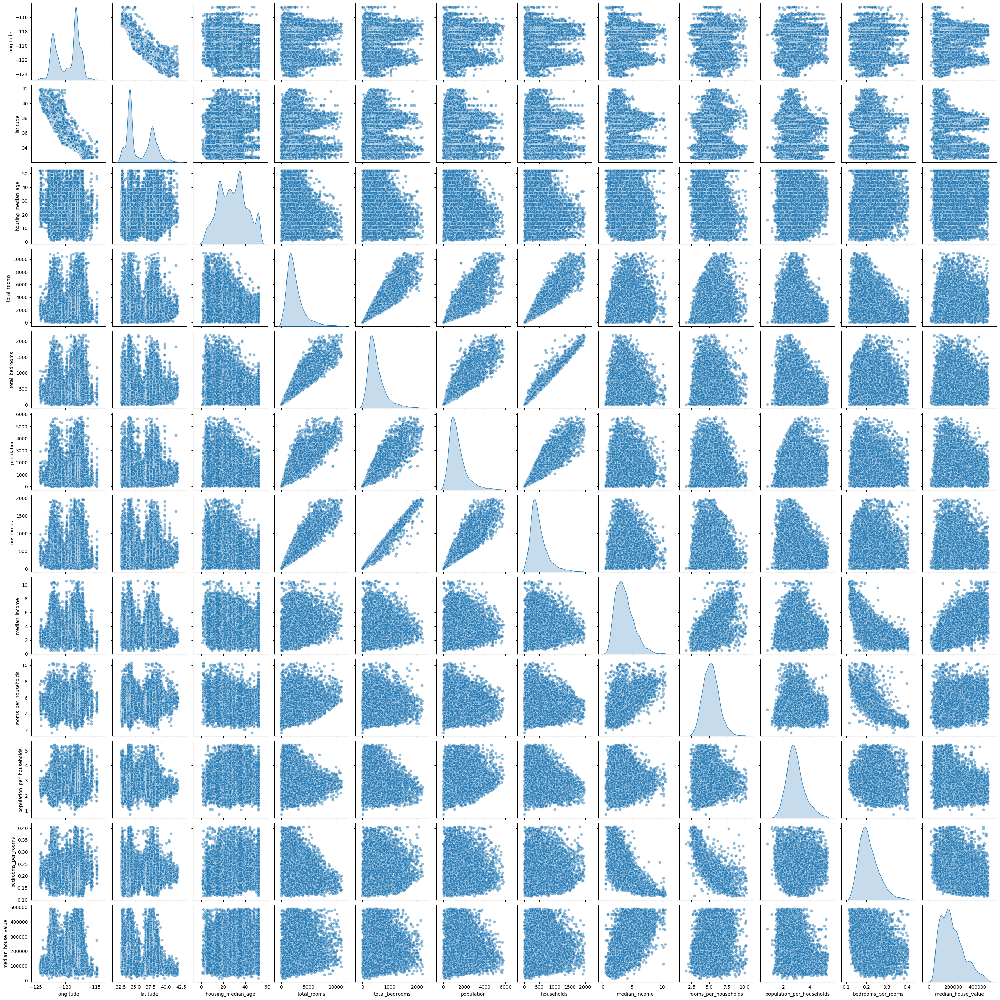

In [13]:
# Verificando o comportamento de cada coluna númerica comparada par a par
sns.pairplot(
    df[numeric_columns + target_column], 
    diag_kind="kde", 
    plot_kws=dict(alpha=0.5)
    );

Percebe-se que há muito ruído na coluna`median_income`. Assim, talvez seja interessante discretizá-lo, para suavizar os dados com comportamento distinto dos demais.

In [14]:
# Discretizando a coluna median_income

limits = np.append(np.arange(0, 7, 1.5), np.inf)

print(limits)

df["median_income_cat"] = pd.cut(
    df["median_income"],
    bins=limits,
    labels=np.arange(1, len(limits))
)

[0.  1.5 3.  4.5 6.  inf]


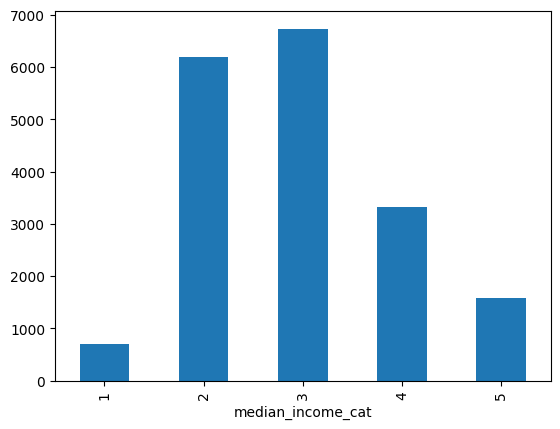

In [15]:
df["median_income_cat"].value_counts().sort_index().plot(kind="bar");

In [16]:
# Verificando o comportamento de "median_income_cat" em relação a coluna alvo

df.groupby("median_income_cat")["median_house_value"].median()

/tmp/ipykernel_1274/1472038617.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby("median_income_cat")["median_house_value"].median()


median_income_cat
1     86400.0
2    117500.0
3    179800.0
4    237400.0
5    332600.0
Name: median_house_value, dtype: float64

Para as demais colunas com ruído, como a target `median_house_value` e a `housing_median_age`, adotaremos uma seleção pelo 99-percentil. Isso será aplicado as demais colunas numéricas, com o intuito também de tirar alguns outliers superiores (O `median_income` será considerado também, apesar de já discretizado, para verificar o seu comportamento como atributo numérico).

In [17]:
# Gerando um novo Dataframe copia do original
df_clean = df.copy()

In [18]:
numeric_columns

['longitude',
 'latitude',
 'housing_median_age',
 'total_rooms',
 'total_bedrooms',
 'population',
 'households',
 'median_income',
 'rooms_per_households',
 'population_per_households',
 'bedrooms_per_rooms']

As colunas `longitude` e `latitude` não serão consideradas, pois não possuem outliers

In [19]:
# Verificando o n-percentil de cada coluna numérica e da alvo que é menor que o valor máximo dela

quantiles = []

for column in numeric_columns[3:] + target_column:

    quantile = 1

    while df[column].quantile(quantile) == df[column].max():

        quantile -= 0.01

    quantiles.append(quantile)

In [20]:
quantiles

[0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99, 0.99]

In [21]:
# Selecionando os objetos com valor menor que o n-percentil correspondente a cada coluna numérica e da target

query = " and ".join(
    [
        f"{column} < {df[column].quantile(quantile)}" 
        for column, quantile in zip(numeric_columns[3:] + target_column, quantiles)
        ]
    )
df_clean = df_clean.query(query)

Assim como feito com `median_income`, também iremos tentar reduzir o ruído por meio da discretização na coluna `housing_median_age`

In [22]:
# Discretizando a coluna housing_median_age

limits = [0, 18, 30, 50, np.inf]

df_clean["housing_median_age_cat"] = pd.cut(df_clean["housing_median_age"], bins=limits, labels=np.arange(1, len(limits)))

In [23]:
# Verificando a correlação de spearman entre a coluna alvo e housing_median_age
df_clean[target_column[0]].corr(df_clean["housing_median_age_cat"], method="spearman")

np.float64(0.06953208268907987)

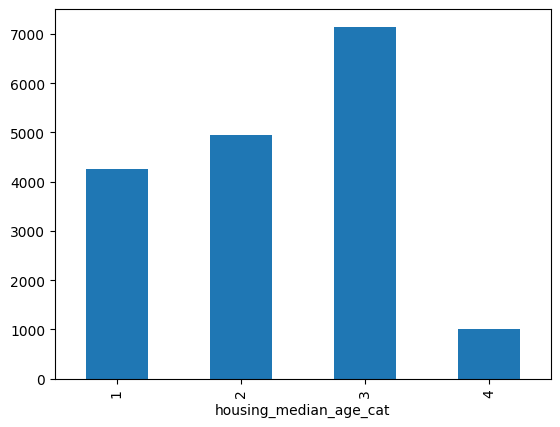

In [24]:
# Verificando a contagem de valores de "housing_median_age_cat"

df_clean["housing_median_age_cat"].value_counts().sort_index().plot(kind="bar");

In [25]:
# Verificando o comportamento de "housing_median_age_cat" em relação a coluna alvo

df_clean.groupby("housing_median_age_cat")["median_house_value"].median()

/tmp/ipykernel_1274/2725326543.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_clean.groupby("housing_median_age_cat")["median_house_value"].median()


housing_median_age_cat
1    161700.0
2    176100.0
3    172000.0
4    232350.0
Name: median_house_value, dtype: float64

In [26]:
# Verificando a porcentagem de objetos "perdidos"
1 - df_clean.shape[0] / df.shape[0]

0.06472491909385114

In [27]:
# Resumo estatístico da base filtrada
df_clean.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_households,population_per_households,bedrooms_per_rooms
count,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000,17340.000000
mean,-119.619751,35.699425,28.938005,2368.008997,487.672030,1306.215340,459.771280,3.621368,187296.412803,5.209242,2.899241,0.211224
std,2.011689,2.160501,12.273909,1344.864596,273.676563,726.237564,253.087024,1.427621,91577.669960,1.029254,0.656502,0.044694
min,-124.349998,32.540001,1.000000,6.000000,2.000000,3.000000,2.000000,0.499900,14999.000000,1.714286,0.750000,0.115385
25%,-121.809998,33.939999,19.000000,1452.000000,296.000000,799.000000,284.000000,2.541700,113900.000000,4.462025,2.450063,0.178407
50%,-118.660004,34.400002,29.000000,2084.500000,428.000000,1159.000000,407.000000,3.443200,171800.000000,5.175991,2.828804,0.204072
75%,-118.019997,37.740002,37.000000,2990.000000,619.000000,1665.000000,583.000000,4.527800,243200.000000,5.900000,3.274911,0.238035
max,-114.550003,41.950001,52.000000,8301.000000,1636.000000,4383.000000,1509.000000,8.103900,453700.000000,8.269231,4.891473,0.360846


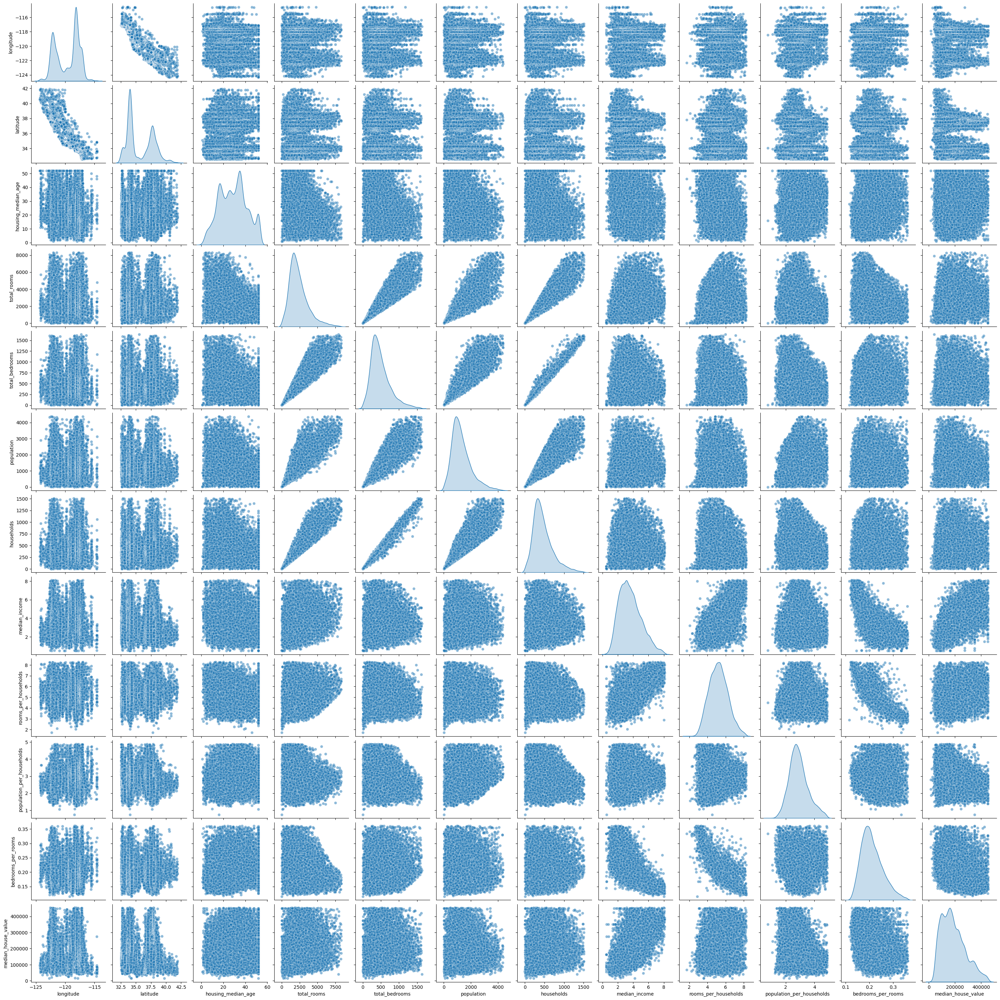

In [28]:
# Verificando novamente o comportamento de cada coluna númerica comparada par a par
sns.pairplot(
    df_clean[numeric_columns + target_column], 
    diag_kind="kde", 
    plot_kws=dict(alpha=0.5)
    );

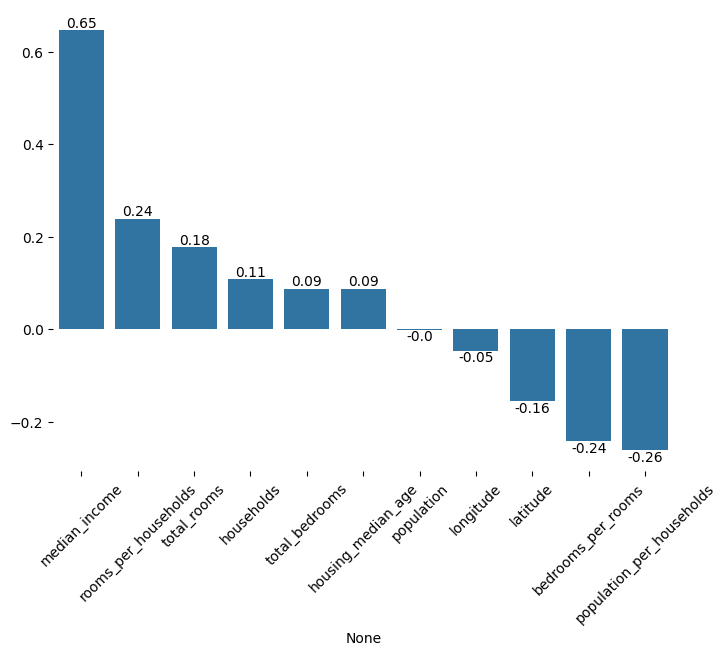

In [29]:
# Verificando a correlação de pearson entre a coluna alvo com as colunas numéricas

fig, ax = plt.subplots(figsize=(8, 6))

df_target_corr = df_clean[
    numeric_columns + target_column
    ].corr()[target_column].sort_values(
        by=target_column[0], 
        ascending=False
    )[1:]

b = sns.barplot(
    x=df_target_corr.index, 
    y=df_target_corr.values.reshape(-1),
    ax=ax
    )

for container in b.containers:

    b.bar_label(container, labels=[round(artist.get_height(), 2) for artist in container])

ax.set_frame_on(False)

ax.tick_params(axis='x', labelrotation=45)

plt.show()

In [30]:
# Verificando o comportamento de "ocean_proximity" em relação a coluna alvo

df_clean.groupby("ocean_proximity")["median_house_value"].median().sort_values()

/tmp/ipykernel_1274/3594788580.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_clean.groupby("ocean_proximity")["median_house_value"].median().sort_values()


ocean_proximity
INLAND        104750.0
<1H OCEAN     206900.0
NEAR BAY      214050.0
NEAR OCEAN    214700.0
Name: median_house_value, dtype: float64

In [31]:
# Verificando o comportamento de "ocean_proximity" em relação a "median_income_cat"

df_clean.groupby(["ocean_proximity", "median_income_cat"]).size().unstack().apply(lambda x: x / x.sum(), axis=1).mul(100).round(2)

/tmp/ipykernel_1274/876112934.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_clean.groupby(["ocean_proximity", "median_income_cat"]).size().unstack().apply(lambda x: x / x.sum(), axis=1).mul(100).round(2)


median_income_cat,1,2,3,4,5
ocean_proximity,,,,,
<1H OCEAN,2.00,25.75,38.56,23.49,10.20
INLAND,6.19,46.04,33.70,10.93,3.13
NEAR BAY,3.44,27.91,39.62,19.33,9.69
NEAR OCEAN,2.56,33.36,39.31,19.24,5.53


In [32]:
# Exportando a base tratada
df_clean.to_parquet(CLEANED_PATH, index=False)